I need to use tiling of the images and masks because independent binary masks explode RAM

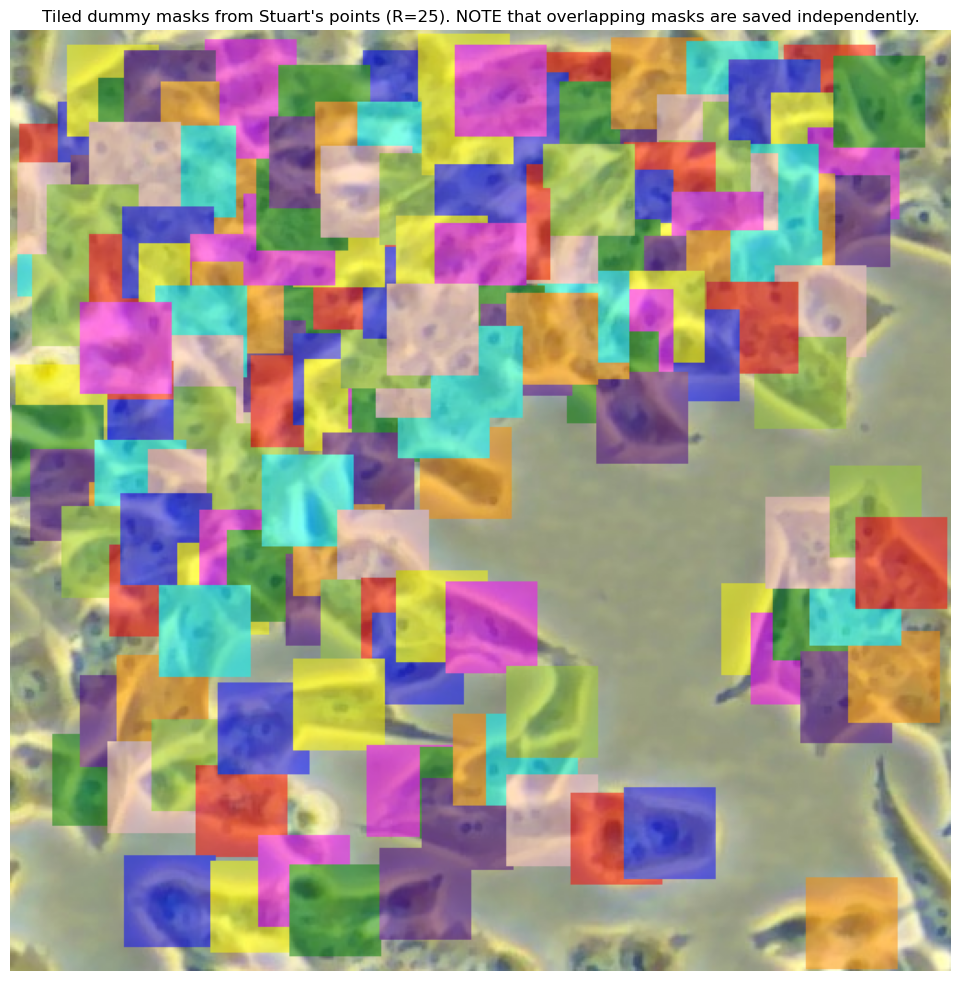

In [1]:
import sys, os; sys.path += ['..']  # NOTE important to find shared modules

import matplotlib.pyplot as plt
import numpy as np
import json
from skimage.color import label2rgb

import torch
from torchvision.io import read_image
from torchvision.ops.boxes import masks_to_boxes
from torchvision import tv_tensors
from torchvision.transforms.v2 import functional as F

import scipy.ndimage
from points2masks_tiled import *

R = 25
_,TILES = make_tiles_dummyBox(R=R, every_nth=1)

class ThirdDataset(torch.utils.data.Dataset):
  def __init__(self, transforms):
    self.tiles = TILES
    self.transforms = transforms

  def __len__(self): return len(self.tiles)
        
  def __getitem__(self, I):
    img, masks = load_tile(self.tiles[I])
    masks = torch.from_numpy(masks)

    num_objs = len(masks)

    # get bounding box coordinates for each mask
    boxes = masks_to_boxes(masks)

    # there is only one class
    labels = torch.ones((num_objs,), dtype=torch.int64)

    area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
    # suppose all instances are not crowd
    iscrowd = torch.zeros((num_objs,), dtype=torch.int64)

    # Wrap sample and targets into torchvision tv_tensors:
    img = tv_tensors.Image(img)

    target = dict(
      boxes=tv_tensors.BoundingBoxes(boxes, format="XYXY", canvas_size=img.shape[-2:]),
      masks=tv_tensors.Mask(masks),
      labels=labels,
      image_id=I,
      area=area,
      iscrowd=iscrowd,
    )

    if self.transforms is not None:
      img, target = self.transforms(img, target)

    return img, target
  


plot_tile(TILES[0], R=R)

---
# Model

In [2]:

######################################################################
# Object detection and instance segmentation model for PennFudan Dataset
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
#
# In our case, we want to finetune from a pre-trained model, given that
# our dataset is very small, so we will be following approach number 1.
#
# Here we want to also compute the instance segmentation masks, so we will
# be using Mask R-CNN:


import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor


def get_model_instance_segmentation(num_classes):
    # load an instance segmentation model pre-trained on COCO
    model = torchvision.models.detection.maskrcnn_resnet50_fpn(weights="DEFAULT")

    # get number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    # now get the number of input features for the mask classifier
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer = 256
    # and replace the mask predictor with a new one
    model.roi_heads.mask_predictor = MaskRCNNPredictor(
        in_features_mask,
        hidden_layer,
        num_classes
    )

    return model

False and os.system("""
mkdir -p references;
cd referencesf;
wget -nc https://raw.githubusercontent.com/pytorch/vision/main/references/detection/utils.py;
wget -nc https://raw.githubusercontent.com/pytorch/vision/main/references/detection/transforms.py;
wget -nc https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_eval.py;
wget -nc https://raw.githubusercontent.com/pytorch/vision/main/references/detection/engine.py;
wget -nc https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_utils.py;
""")

False

In [3]:


from torchvision.transforms import v2 as T


def get_transform(train):
    
    transforms = []
    if train:
        transforms.append(T.RandomHorizontalFlip(0.5))
    transforms.append(T.ConvertImageDtype(torch.float))  #transforms.append(T.ToDtype(torch.float), scale=True))  # NOTE torchvision 0.17
    #transforms.append(T.ToPureTensor()) # NOTE torchvision 0.17 
    return T.Compose(transforms)

In [4]:

######################################################################
# Let’s now write the main function which performs the training and the
# validation:


from references.engine import train_one_epoch, evaluate
import references.utils as utils

# train on the GPU or on the CPU, if a GPU is not available
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# our dataset has two classes only - background and person
num_classes = 2
# use our dataset and defined transformations
dataset = ThirdDataset(get_transform(train=True))
dataset_test = ThirdDataset(get_transform(train=False))

# split the dataset in train and test set
# NOTE TODO: reintroduce splits
# indices = torch.randperm(len(dataset)).tolist()
# dataset = torch.utils.data.Subset(dataset, indices[:-50])
# dataset_test = torch.utils.data.Subset(dataset_test, indices[-50:])

# define training and validation data loaders
data_loader = torch.utils.data.DataLoader(
    dataset,
    batch_size=2,
    shuffle=True,
    num_workers=4,
    collate_fn=utils.collate_fn
)

data_loader_test = torch.utils.data.DataLoader(
    dataset_test,
    batch_size=1,
    shuffle=False,
    num_workers=4,
    collate_fn=utils.collate_fn
)

# get the model using our helper function
model = get_model_instance_segmentation(num_classes)

# move model to the right device
model.to(device)

# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(
    params,
    lr=0.005,
    momentum=0.9,
    weight_decay=0.0005
)

# and a learning rate scheduler
lr_scheduler = torch.optim.lr_scheduler.StepLR(
    optimizer,
    step_size=3,
    gamma=0.1
)

In [5]:
# let's train it for 5 epochs
num_epochs = 10  # NOTE!!

for epoch in range(num_epochs):
    # train for one epoch, printing every 10 iterations
    train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=1)
    # update the learning rate
    lr_scheduler.step()
    
    # NOTE this raises "ValueError: Buffer dtype mismatch, expected 'uint8_t' but got 'float'" somewhere deep down
    #evaluate(model, data_loader_test, device=device)

print("That's it!")

Epoch: [0]  [0/6]  eta: 0:00:25  lr: 0.001004  loss: 8.2773 (8.2773)  loss_classifier: 0.7230 (0.7230)  loss_box_reg: 0.7579 (0.7579)  loss_mask: 1.8560 (1.8560)  loss_objectness: 4.7510 (4.7510)  loss_rpn_box_reg: 0.1894 (0.1894)  time: 4.1973  data: 1.1906  max mem: 2547


Epoch: [0]  [1/6]  eta: 0:00:11  lr: 0.002003  loss: 7.5953 (7.9363)  loss_classifier: 0.7068 (0.7149)  loss_box_reg: 0.7579 (0.7598)  loss_mask: 1.8035 (1.8298)  loss_objectness: 4.1360 (4.4435)  loss_rpn_box_reg: 0.1873 (0.1884)  time: 2.2824  data: 0.6244  max mem: 2648


Epoch: [0]  [2/6]  eta: 0:00:06  lr: 0.003002  loss: 7.5953 (6.1116)  loss_classifier: 0.7068 (0.6909)  loss_box_reg: 0.7579 (0.7547)  loss_mask: 1.8035 (1.4532)  loss_objectness: 4.1360 (3.0463)  loss_rpn_box_reg: 0.1873 (0.1664)  time: 1.6292  data: 0.4295  max mem: 2648


Epoch: [0]  [3/6]  eta: 0:00:03  lr: 0.004001  loss: 2.4622 (5.1459)  loss_classifier: 0.6428 (0.6558)  loss_box_reg: 0.7447 (0.7391)  loss_mask: 0.7002 (1.2459)  loss_objectness: 0.2731 (2.3530)  loss_rpn_box_reg: 0.1226 (0.1521)  time: 1.3037  data: 0.3311  max mem: 2670


Epoch: [0]  [4/6]  eta: 0:00:02  lr: 0.005000  loss: 2.7455 (4.6658)  loss_classifier: 0.6428 (0.6250)  loss_box_reg: 0.7447 (0.7326)  loss_mask: 1.1500 (1.2267)  loss_objectness: 0.2848 (1.9394)  loss_rpn_box_reg: 0.1226 (0.1422)  time: 1.1056  data: 0.2732  max mem: 2670


Epoch: [0]  [5/6]  eta: 0:00:00  lr: 0.005000  loss: 2.4622 (4.1605)  loss_classifier: 0.5505 (0.5914)  loss_box_reg: 0.7064 (0.6924)  loss_mask: 0.7002 (1.1171)  loss_objectness: 0.2731 (1.6362)  loss_rpn_box_reg: 0.1090 (0.1234)  time: 0.9761  data: 0.2334  max mem: 2670
Epoch: [0] Total time: 0:00:05 (0.9880 s / it)


Epoch: [1]  [0/6]  eta: 0:00:09  lr: 0.005000  loss: 1.7961 (1.7961)  loss_classifier: 0.4389 (0.4389)  loss_box_reg: 0.3889 (0.3889)  loss_mask: 0.3612 (0.3612)  loss_objectness: 0.5847 (0.5847)  loss_rpn_box_reg: 0.0224 (0.0224)  time: 1.6615  data: 1.3112  max mem: 2852


Epoch: [1]  [1/6]  eta: 0:00:05  lr: 0.005000  loss: 1.7961 (1.8295)  loss_classifier: 0.4389 (0.4817)  loss_box_reg: 0.1778 (0.2833)  loss_mask: 0.2245 (0.2929)  loss_objectness: 0.5832 (0.5840)  loss_rpn_box_reg: 0.0224 (0.1877)  time: 1.0131  data: 0.6808  max mem: 2852


Epoch: [1]  [2/6]  eta: 0:00:03  lr: 0.005000  loss: 1.8628 (2.5573)  loss_classifier: 0.4389 (0.4507)  loss_box_reg: 0.1778 (0.2242)  loss_mask: 0.2245 (0.2226)  loss_objectness: 0.5847 (0.6314)  loss_rpn_box_reg: 0.3529 (1.0284)  time: 0.7863  data: 0.4681  max mem: 2852


Epoch: [1]  [3/6]  eta: 0:00:02  lr: 0.005000  loss: 1.8628 (2.4436)  loss_classifier: 0.4389 (0.4857)  loss_box_reg: 0.1778 (0.2415)  loss_mask: 0.2245 (0.2238)  loss_objectness: 0.5832 (0.5801)  loss_rpn_box_reg: 0.3529 (0.9126)  time: 0.6717  data: 0.3601  max mem: 2852


Epoch: [1]  [4/6]  eta: 0:00:01  lr: 0.005000  loss: 2.1025 (3.3886)  loss_classifier: 0.4825 (0.4851)  loss_box_reg: 0.1778 (0.1966)  loss_mask: 0.2245 (0.1848)  loss_objectness: 0.5832 (0.5492)  loss_rpn_box_reg: 0.5651 (1.9730)  time: 0.6062  data: 0.2970  max mem: 2852


Epoch: [1]  [5/6]  eta: 0:00:00  lr: 0.005000  loss: 2.1025 (3.2686)  loss_classifier: 0.4825 (0.5057)  loss_box_reg: 0.1059 (0.1684)  loss_mask: 0.0822 (0.1612)  loss_objectness: 0.4261 (0.4842)  loss_rpn_box_reg: 0.5651 (1.9491)  time: 0.5601  data: 0.2537  max mem: 2852
Epoch: [1] Total time: 0:00:03 (0.5778 s / it)


Epoch: [2]  [0/6]  eta: 0:00:10  lr: 0.005000  loss: 3.6757 (3.6757)  loss_classifier: 1.1176 (1.1176)  loss_box_reg: 0.0423 (0.0423)  loss_mask: 0.0401 (0.0401)  loss_objectness: 1.0511 (1.0511)  loss_rpn_box_reg: 1.4246 (1.4246)  time: 1.7069  data: 1.3714  max mem: 2883


Epoch: [2]  [1/6]  eta: 0:00:05  lr: 0.005000  loss: 3.6757 (7.9068)  loss_classifier: 0.7632 (0.9404)  loss_box_reg: 0.0423 (0.5248)  loss_mask: 0.0401 (2.6611)  loss_objectness: 1.0511 (2.7184)  loss_rpn_box_reg: 0.6997 (1.0621)  time: 1.0200  data: 0.7058  max mem: 2883


Epoch: [2]  [2/6]  eta: 0:00:03  lr: 0.005000  loss: 3.6757 (5.9659)  loss_classifier: 0.7632 (0.7819)  loss_box_reg: 0.8670 (0.6389)  loss_mask: 0.3637 (1.8953)  loss_objectness: 1.0511 (1.9309)  loss_rpn_box_reg: 0.6997 (0.7189)  time: 0.7856  data: 0.4837  max mem: 2883


Epoch: [2]  [3/6]  eta: 0:00:02  lr: 0.005000  loss: 2.0839 (4.9891)  loss_classifier: 0.4648 (0.6945)  loss_box_reg: 0.8670 (0.6992)  loss_mask: 0.3637 (1.5412)  loss_objectness: 0.3559 (1.5079)  loss_rpn_box_reg: 0.0325 (0.5463)  time: 0.6751  data: 0.3714  max mem: 2883


Epoch: [2]  [4/6]  eta: 0:00:01  lr: 0.005000  loss: 2.1024 (4.4117)  loss_classifier: 0.4648 (0.6360)  loss_box_reg: 0.8670 (0.7126)  loss_mask: 0.4790 (1.3623)  loss_objectness: 0.3559 (1.2478)  loss_rpn_box_reg: 0.0803 (0.4531)  time: 0.6028  data: 0.3053  max mem: 2883


Epoch: [2]  [5/6]  eta: 0:00:00  lr: 0.005000  loss: 2.0839 (4.0223)  loss_classifier: 0.4324 (0.5999)  loss_box_reg: 0.7660 (0.6980)  loss_mask: 0.4790 (1.2296)  loss_objectness: 0.2387 (1.0764)  loss_rpn_box_reg: 0.0803 (0.4184)  time: 0.5550  data: 0.2600  max mem: 2883
Epoch: [2] Total time: 0:00:03 (0.5770 s / it)


Epoch: [3]  [0/6]  eta: 0:00:08  lr: 0.000500  loss: 1.9643 (1.9643)  loss_classifier: 0.5526 (0.5526)  loss_box_reg: 0.7307 (0.7307)  loss_mask: 0.3974 (0.3974)  loss_objectness: 0.1291 (0.1291)  loss_rpn_box_reg: 0.1546 (0.1546)  time: 1.4472  data: 1.1441  max mem: 2883


Epoch: [3]  [1/6]  eta: 0:00:04  lr: 0.000500  loss: 1.8985 (1.9314)  loss_classifier: 0.5468 (0.5497)  loss_box_reg: 0.7307 (0.7526)  loss_mask: 0.3432 (0.3703)  loss_objectness: 0.1122 (0.1206)  loss_rpn_box_reg: 0.1217 (0.1381)  time: 0.8791  data: 0.5898  max mem: 2883


Epoch: [3]  [2/6]  eta: 0:00:02  lr: 0.000500  loss: 1.8985 (1.9090)  loss_classifier: 0.5468 (0.5468)  loss_box_reg: 0.7307 (0.7444)  loss_mask: 0.3749 (0.3718)  loss_objectness: 0.1291 (0.1312)  loss_rpn_box_reg: 0.1217 (0.1147)  time: 0.6898  data: 0.4031  max mem: 2883


Epoch: [3]  [3/6]  eta: 0:00:01  lr: 0.000500  loss: 1.8642 (1.8587)  loss_classifier: 0.5410 (0.5437)  loss_box_reg: 0.7280 (0.7234)  loss_mask: 0.3749 (0.3791)  loss_objectness: 0.1122 (0.1202)  loss_rpn_box_reg: 0.0679 (0.0923)  time: 0.6036  data: 0.3098  max mem: 2883


Epoch: [3]  [4/6]  eta: 0:00:01  lr: 0.000500  loss: 1.8642 (1.8285)  loss_classifier: 0.5410 (0.5339)  loss_box_reg: 0.7280 (0.6912)  loss_mask: 0.3974 (0.4038)  loss_objectness: 0.1209 (0.1203)  loss_rpn_box_reg: 0.0679 (0.0793)  time: 0.5529  data: 0.2584  max mem: 2883


Epoch: [3]  [5/6]  eta: 0:00:00  lr: 0.000500  loss: 1.8443 (1.8311)  loss_classifier: 0.5344 (0.5241)  loss_box_reg: 0.6605 (0.6769)  loss_mask: 0.3974 (0.4299)  loss_objectness: 0.1209 (0.1247)  loss_rpn_box_reg: 0.0563 (0.0755)  time: 0.5133  data: 0.2219  max mem: 2883
Epoch: [3] Total time: 0:00:03 (0.5360 s / it)


Epoch: [4]  [0/6]  eta: 0:00:08  lr: 0.000500  loss: 1.8866 (1.8866)  loss_classifier: 0.4667 (0.4667)  loss_box_reg: 0.6210 (0.6210)  loss_mask: 0.5584 (0.5584)  loss_objectness: 0.1672 (0.1672)  loss_rpn_box_reg: 0.0734 (0.0734)  time: 1.4246  data: 1.0835  max mem: 2883


Epoch: [4]  [1/6]  eta: 0:00:04  lr: 0.000500  loss: 1.8599 (1.8733)  loss_classifier: 0.4556 (0.4611)  loss_box_reg: 0.6210 (0.6291)  loss_mask: 0.5584 (0.5695)  loss_objectness: 0.1279 (0.1475)  loss_rpn_box_reg: 0.0587 (0.0660)  time: 0.8747  data: 0.5647  max mem: 2883


Epoch: [4]  [2/6]  eta: 0:00:02  lr: 0.000500  loss: 1.8599 (1.8046)  loss_classifier: 0.4620 (0.4614)  loss_box_reg: 0.6210 (0.6001)  loss_mask: 0.5584 (0.5526)  loss_objectness: 0.1279 (0.1343)  loss_rpn_box_reg: 0.0587 (0.0561)  time: 0.7026  data: 0.3899  max mem: 2900


Epoch: [4]  [3/6]  eta: 0:00:01  lr: 0.000500  loss: 1.6673 (1.7521)  loss_classifier: 0.4620 (0.4634)  loss_box_reg: 0.5422 (0.5757)  loss_mask: 0.5189 (0.5352)  loss_objectness: 0.1204 (0.1308)  loss_rpn_box_reg: 0.0363 (0.0470)  time: 0.6098  data: 0.3040  max mem: 2900


Epoch: [4]  [4/6]  eta: 0:00:01  lr: 0.000500  loss: 1.6673 (1.6999)  loss_classifier: 0.4620 (0.4613)  loss_box_reg: 0.5422 (0.5526)  loss_mask: 0.5189 (0.5160)  loss_objectness: 0.1204 (0.1287)  loss_rpn_box_reg: 0.0363 (0.0412)  time: 0.5580  data: 0.2514  max mem: 2900


Epoch: [4]  [5/6]  eta: 0:00:00  lr: 0.000500  loss: 1.5946 (1.6732)  loss_classifier: 0.4565 (0.4605)  loss_box_reg: 0.5142 (0.5462)  loss_mask: 0.4828 (0.5024)  loss_objectness: 0.1203 (0.1266)  loss_rpn_box_reg: 0.0195 (0.0375)  time: 0.5201  data: 0.2169  max mem: 2900
Epoch: [4] Total time: 0:00:03 (0.5375 s / it)


Epoch: [5]  [0/6]  eta: 0:00:08  lr: 0.000500  loss: 1.4864 (1.4864)  loss_classifier: 0.4677 (0.4677)  loss_box_reg: 0.4845 (0.4845)  loss_mask: 0.3990 (0.3990)  loss_objectness: 0.1118 (0.1118)  loss_rpn_box_reg: 0.0234 (0.0234)  time: 1.4589  data: 1.1077  max mem: 2900


Epoch: [5]  [1/6]  eta: 0:00:04  lr: 0.000500  loss: 1.4864 (1.5298)  loss_classifier: 0.4677 (0.4706)  loss_box_reg: 0.4845 (0.5079)  loss_mask: 0.3990 (0.4051)  loss_objectness: 0.1118 (0.1219)  loss_rpn_box_reg: 0.0234 (0.0243)  time: 0.9381  data: 0.5858  max mem: 2900


Epoch: [5]  [2/6]  eta: 0:00:03  lr: 0.000500  loss: 1.5732 (1.5600)  loss_classifier: 0.4735 (0.4798)  loss_box_reg: 0.5313 (0.5172)  loss_mask: 0.4112 (0.4086)  loss_objectness: 0.1321 (0.1301)  loss_rpn_box_reg: 0.0239 (0.0242)  time: 0.7542  data: 0.4097  max mem: 2900


Epoch: [5]  [3/6]  eta: 0:00:01  lr: 0.000500  loss: 1.5358 (1.5539)  loss_classifier: 0.4677 (0.4762)  loss_box_reg: 0.5276 (0.5198)  loss_mask: 0.4112 (0.4096)  loss_objectness: 0.1118 (0.1246)  loss_rpn_box_reg: 0.0234 (0.0237)  time: 0.6654  data: 0.3198  max mem: 2900


Epoch: [5]  [4/6]  eta: 0:00:01  lr: 0.000500  loss: 1.5509 (1.5533)  loss_classifier: 0.4677 (0.4734)  loss_box_reg: 0.5276 (0.5189)  loss_mask: 0.4125 (0.4125)  loss_objectness: 0.1270 (0.1251)  loss_rpn_box_reg: 0.0234 (0.0234)  time: 0.6145  data: 0.2689  max mem: 2900


Epoch: [5]  [5/6]  eta: 0:00:00  lr: 0.000500  loss: 1.5358 (1.5308)  loss_classifier: 0.4655 (0.4686)  loss_box_reg: 0.5153 (0.5101)  loss_mask: 0.4125 (0.4134)  loss_objectness: 0.1118 (0.1155)  loss_rpn_box_reg: 0.0223 (0.0232)  time: 0.5768  data: 0.2330  max mem: 2900
Epoch: [5] Total time: 0:00:03 (0.6004 s / it)


Epoch: [6]  [0/6]  eta: 0:00:09  lr: 0.000050  loss: 1.4103 (1.4103)  loss_classifier: 0.4263 (0.4263)  loss_box_reg: 0.4530 (0.4530)  loss_mask: 0.4219 (0.4219)  loss_objectness: 0.0876 (0.0876)  loss_rpn_box_reg: 0.0215 (0.0215)  time: 1.5741  data: 1.2460  max mem: 2900


Epoch: [6]  [1/6]  eta: 0:00:04  lr: 0.000050  loss: 1.4103 (1.4332)  loss_classifier: 0.4263 (0.4319)  loss_box_reg: 0.4530 (0.4667)  loss_mask: 0.4219 (0.4287)  loss_objectness: 0.0801 (0.0839)  loss_rpn_box_reg: 0.0215 (0.0220)  time: 0.9543  data: 0.6457  max mem: 2900


Epoch: [6]  [2/6]  eta: 0:00:02  lr: 0.000050  loss: 1.4305 (1.4323)  loss_classifier: 0.4374 (0.4340)  loss_box_reg: 0.4535 (0.4623)  loss_mask: 0.4228 (0.4267)  loss_objectness: 0.0876 (0.0871)  loss_rpn_box_reg: 0.0224 (0.0221)  time: 0.7466  data: 0.4430  max mem: 2900


Epoch: [6]  [3/6]  eta: 0:00:01  lr: 0.000050  loss: 1.4305 (1.4382)  loss_classifier: 0.4263 (0.4317)  loss_box_reg: 0.4530 (0.4594)  loss_mask: 0.4219 (0.4251)  loss_objectness: 0.0876 (0.1006)  loss_rpn_box_reg: 0.0215 (0.0214)  time: 0.6447  data: 0.3420  max mem: 2900


Epoch: [6]  [4/6]  eta: 0:00:01  lr: 0.000050  loss: 1.4305 (1.4307)  loss_classifier: 0.4263 (0.4293)  loss_box_reg: 0.4530 (0.4576)  loss_mask: 0.4228 (0.4248)  loss_objectness: 0.0876 (0.0971)  loss_rpn_box_reg: 0.0224 (0.0218)  time: 0.5827  data: 0.2836  max mem: 2900


Epoch: [6]  [5/6]  eta: 0:00:00  lr: 0.000050  loss: 1.4305 (1.4338)  loss_classifier: 0.4263 (0.4331)  loss_box_reg: 0.4509 (0.4564)  loss_mask: 0.4228 (0.4245)  loss_objectness: 0.0876 (0.0980)  loss_rpn_box_reg: 0.0217 (0.0218)  time: 0.5372  data: 0.2421  max mem: 2900
Epoch: [6] Total time: 0:00:03 (0.5566 s / it)


Epoch: [7]  [0/6]  eta: 0:00:09  lr: 0.000050  loss: 1.4338 (1.4338)  loss_classifier: 0.4184 (0.4184)  loss_box_reg: 0.4716 (0.4716)  loss_mask: 0.4338 (0.4338)  loss_objectness: 0.0894 (0.0894)  loss_rpn_box_reg: 0.0206 (0.0206)  time: 1.6123  data: 1.2381  max mem: 2900


Epoch: [7]  [1/6]  eta: 0:00:04  lr: 0.000050  loss: 1.4338 (1.4554)  loss_classifier: 0.4184 (0.4303)  loss_box_reg: 0.4716 (0.4807)  loss_mask: 0.4338 (0.4369)  loss_objectness: 0.0852 (0.0873)  loss_rpn_box_reg: 0.0200 (0.0203)  time: 0.9621  data: 0.6379  max mem: 2900


Epoch: [7]  [2/6]  eta: 0:00:02  lr: 0.000050  loss: 1.4771 (1.4765)  loss_classifier: 0.4261 (0.4289)  loss_box_reg: 0.4897 (0.4876)  loss_mask: 0.4399 (0.4401)  loss_objectness: 0.0894 (0.1007)  loss_rpn_box_reg: 0.0200 (0.0192)  time: 0.7406  data: 0.4347  max mem: 2900


Epoch: [7]  [3/6]  eta: 0:00:01  lr: 0.000050  loss: 1.4338 (1.4516)  loss_classifier: 0.4222 (0.4272)  loss_box_reg: 0.4716 (0.4721)  loss_mask: 0.4338 (0.4335)  loss_objectness: 0.0894 (0.0994)  loss_rpn_box_reg: 0.0198 (0.0194)  time: 0.6381  data: 0.3340  max mem: 2900


Epoch: [7]  [4/6]  eta: 0:00:01  lr: 0.000050  loss: 1.4389 (1.4490)  loss_classifier: 0.4222 (0.4229)  loss_box_reg: 0.4784 (0.4734)  loss_mask: 0.4366 (0.4341)  loss_objectness: 0.0953 (0.0997)  loss_rpn_box_reg: 0.0198 (0.0189)  time: 0.5779  data: 0.2766  max mem: 2900


Epoch: [7]  [5/6]  eta: 0:00:00  lr: 0.000050  loss: 1.4338 (1.4432)  loss_classifier: 0.4184 (0.4209)  loss_box_reg: 0.4716 (0.4704)  loss_mask: 0.4338 (0.4330)  loss_objectness: 0.0953 (0.1004)  loss_rpn_box_reg: 0.0171 (0.0185)  time: 0.5385  data: 0.2364  max mem: 2900
Epoch: [7] Total time: 0:00:03 (0.5570 s / it)


Epoch: [8]  [0/6]  eta: 0:00:08  lr: 0.000050  loss: 1.4078 (1.4078)  loss_classifier: 0.4308 (0.4308)  loss_box_reg: 0.4257 (0.4257)  loss_mask: 0.4128 (0.4128)  loss_objectness: 0.1220 (0.1220)  loss_rpn_box_reg: 0.0166 (0.0166)  time: 1.3893  data: 1.0677  max mem: 2900


Epoch: [8]  [1/6]  eta: 0:00:04  lr: 0.000050  loss: 1.4078 (1.4121)  loss_classifier: 0.4229 (0.4268)  loss_box_reg: 0.4257 (0.4453)  loss_mask: 0.4128 (0.4230)  loss_objectness: 0.0791 (0.1005)  loss_rpn_box_reg: 0.0161 (0.0163)  time: 0.8699  data: 0.5613  max mem: 2900


Epoch: [8]  [2/6]  eta: 0:00:02  lr: 0.000050  loss: 1.4163 (1.4176)  loss_classifier: 0.4231 (0.4256)  loss_box_reg: 0.4650 (0.4533)  loss_mask: 0.4333 (0.4305)  loss_objectness: 0.0791 (0.0919)  loss_rpn_box_reg: 0.0161 (0.0163)  time: 0.6852  data: 0.3862  max mem: 2900


Epoch: [8]  [3/6]  eta: 0:00:01  lr: 0.000050  loss: 1.4163 (1.4257)  loss_classifier: 0.4229 (0.4230)  loss_box_reg: 0.4650 (0.4623)  loss_mask: 0.4333 (0.4367)  loss_objectness: 0.0752 (0.0877)  loss_rpn_box_reg: 0.0161 (0.0160)  time: 0.5933  data: 0.2984  max mem: 2900


Epoch: [8]  [4/6]  eta: 0:00:01  lr: 0.000050  loss: 1.4286 (1.4320)  loss_classifier: 0.4229 (0.4202)  loss_box_reg: 0.4693 (0.4649)  loss_mask: 0.4455 (0.4390)  loss_objectness: 0.0791 (0.0920)  loss_rpn_box_reg: 0.0161 (0.0160)  time: 0.5439  data: 0.2468  max mem: 2900


Epoch: [8]  [5/6]  eta: 0:00:00  lr: 0.000050  loss: 1.4163 (1.4203)  loss_classifier: 0.4152 (0.4186)  loss_box_reg: 0.4650 (0.4594)  loss_mask: 0.4333 (0.4362)  loss_objectness: 0.0791 (0.0903)  loss_rpn_box_reg: 0.0161 (0.0157)  time: 0.5132  data: 0.2130  max mem: 2900
Epoch: [8] Total time: 0:00:03 (0.5299 s / it)


Epoch: [9]  [0/6]  eta: 0:00:08  lr: 0.000005  loss: 1.4261 (1.4261)  loss_classifier: 0.4108 (0.4108)  loss_box_reg: 0.4720 (0.4720)  loss_mask: 0.4455 (0.4455)  loss_objectness: 0.0832 (0.0832)  loss_rpn_box_reg: 0.0146 (0.0146)  time: 1.4935  data: 1.1166  max mem: 2900


Epoch: [9]  [1/6]  eta: 0:00:04  lr: 0.000005  loss: 1.3824 (1.4042)  loss_classifier: 0.3992 (0.4050)  loss_box_reg: 0.4364 (0.4542)  loss_mask: 0.4186 (0.4320)  loss_objectness: 0.0832 (0.0982)  loss_rpn_box_reg: 0.0146 (0.0148)  time: 0.9602  data: 0.5900  max mem: 2944


Epoch: [9]  [2/6]  eta: 0:00:03  lr: 0.000005  loss: 1.4261 (1.4159)  loss_classifier: 0.4108 (0.4083)  loss_box_reg: 0.4720 (0.4606)  loss_mask: 0.4455 (0.4383)  loss_objectness: 0.0857 (0.0941)  loss_rpn_box_reg: 0.0147 (0.0147)  time: 0.7702  data: 0.4151  max mem: 2944


Epoch: [9]  [3/6]  eta: 0:00:02  lr: 0.000005  loss: 1.4261 (1.4308)  loss_classifier: 0.4108 (0.4125)  loss_box_reg: 0.4699 (0.4629)  loss_mask: 0.4455 (0.4405)  loss_objectness: 0.0857 (0.1000)  loss_rpn_box_reg: 0.0147 (0.0149)  time: 0.6721  data: 0.3248  max mem: 2944


Epoch: [9]  [4/6]  eta: 0:00:01  lr: 0.000005  loss: 1.4391 (1.4411)  loss_classifier: 0.4147 (0.4133)  loss_box_reg: 0.4711 (0.4645)  loss_mask: 0.4473 (0.4430)  loss_objectness: 0.1133 (0.1053)  loss_rpn_box_reg: 0.0149 (0.0151)  time: 0.6090  data: 0.2715  max mem: 2944


Epoch: [9]  [5/6]  eta: 0:00:00  lr: 0.000005  loss: 1.4391 (1.4416)  loss_classifier: 0.4141 (0.4134)  loss_box_reg: 0.4699 (0.4652)  loss_mask: 0.4455 (0.4424)  loss_objectness: 0.1072 (0.1056)  loss_rpn_box_reg: 0.0147 (0.0150)  time: 0.5654  data: 0.2346  max mem: 2944
Epoch: [9] Total time: 0:00:03 (0.5841 s / it)
That's it!


In [6]:

import matplotlib.pyplot as plt

from torchvision.utils import draw_bounding_boxes, draw_segmentation_masks

import colorcet 
import itertools as it

colors = colorcet.m_glasbey.colors

S = 6

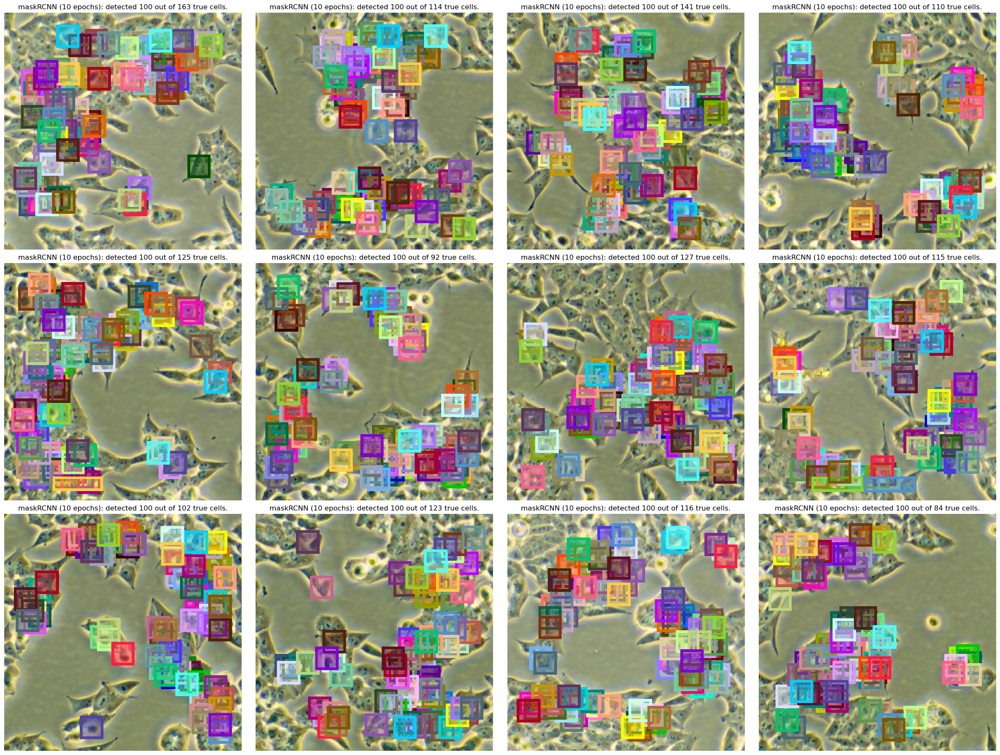

In [7]:

def demo():
    # make a subplot with 3 rows and 4 columns
    fig, axes = plt.subplots(3, 4, figsize=(4*S, 3*S))

    for ax, tile in zip(axes.flatten(), TILES):
        image, gt_seg = load_tile(tile)

        eval_transform = get_transform(train=False)

        model.eval()
        with torch.no_grad():
            x = eval_transform(image)
            # convert RGBA -> RGB and move to device
            x = x[:3, ...].to(device)
            predictions = model([x, ])
            pred = predictions[0]

        image = (255.0 * (image - image.min()) / (image.max() - image.min())).to(torch.uint8)
        image = image[:3, ...]
        pred_labels = [f"cell: {score:.3f}" for label, score in zip(pred["labels"], pred["scores"])]
        pred_boxes = pred["boxes"].long()
        
        cs = [tuple(map(lambda x: int(x*255), c)) for c, _ in zip(it.cycle(colors), pred_boxes)]

        output_image = draw_bounding_boxes(image, pred_boxes, pred_labels, colors=cs, width=S)

        masks = (pred["masks"] > 0.7).squeeze(1)
        output_image = draw_segmentation_masks(output_image, masks, alpha=0.5, colors=cs)
        ax.imshow(output_image.permute(1, 2, 0))
        ax.axis("off")

        ax.set_title(f"maskRCNN ({num_epochs} epochs): detected {len(pred_boxes)} out of {len(gt_seg)} true cells.")
    plt.tight_layout()

demo()

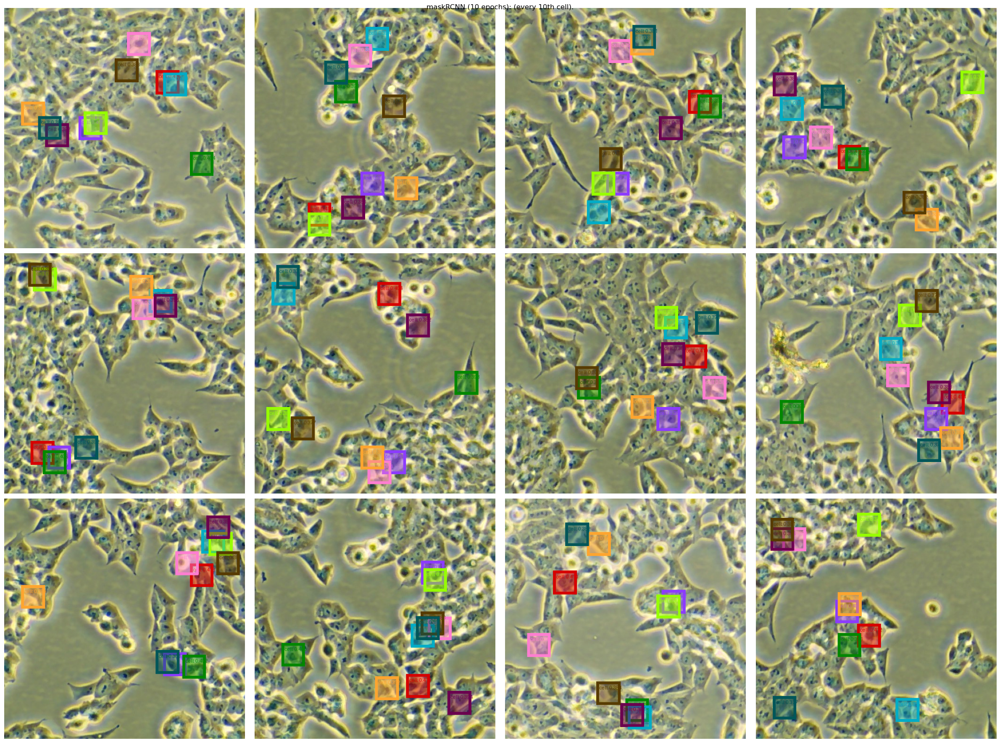

In [8]:

def demo(nth = 10):
    # make a subplot with 3 rows and 4 columns
    fig, axes = plt.subplots(3, 4, figsize=(4*S, 3*S))

    for ax, tile in zip(axes.flatten(), TILES):
        image, gt_seg = load_tile(tile)

        eval_transform = get_transform(train=False)

        model.eval()
        with torch.no_grad():
            x = eval_transform(image)
            # convert RGBA -> RGB and move to device
            x = x[:3, ...].to(device)
            predictions = model([x, ])
            pred = predictions[0]

        image = (255.0 * (image - image.min()) / (image.max() - image.min())).to(torch.uint8)
        image = image[:3, ...]
        pred_labels = [f"cell: {score:.3f}" for label, score in zip(pred["labels"], pred["scores"])][::nth]
        pred_boxes = pred["boxes"].long()[::nth]
        
        cs = [tuple(map(lambda x: int(x*255), c)) for c, _ in zip(it.cycle(colors), pred_boxes)]

        output_image = draw_bounding_boxes(image, pred_boxes, pred_labels, colors=cs, width=S)

        masks = (pred["masks"] > 0.7).squeeze(1)[::nth]
        output_image = draw_segmentation_masks(output_image, masks, alpha=0.5, colors=cs)
        ax.imshow(output_image.permute(1, 2, 0))
        ax.axis("off")

    fig.suptitle(f"maskRCNN ({num_epochs} epochs): (every {nth}th cell).")
    plt.tight_layout()

demo()

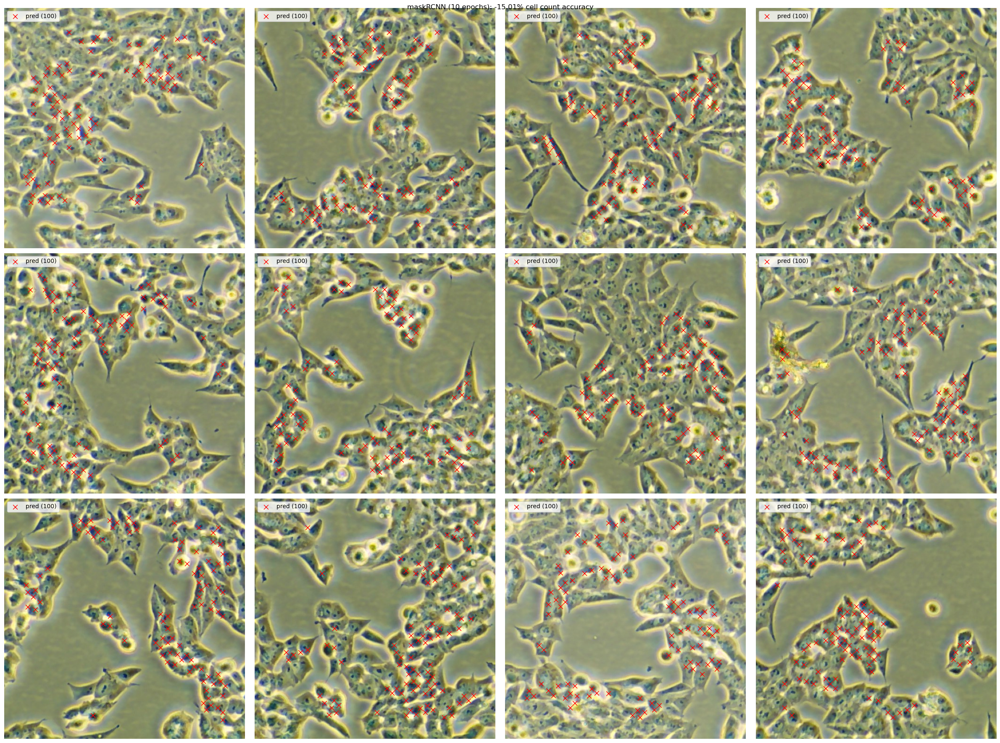

In [9]:

def demo():
    # make a subplot with 3 rows and 4 columns
    fig, axes = plt.subplots(3, 4, figsize=(4*S, 3*S))

    count, gt_count = 0,0

    for ax, tile in zip(axes.flatten(), TILES):
        image, gt_seg = load_tile(tile)

        eval_transform = get_transform(train=False)

        model.eval()
        with torch.no_grad():
            x = eval_transform(image)
            # convert RGBA -> RGB and move to device
            x = x[:3, ...].to(device)
            predictions = model([x, ])
            pred = predictions[0]

        image = (255.0 * (image - image.min()) / (image.max() - image.min())).to(torch.uint8)
        image = image[:3, ...]
        pred_labels = [f"cell: {score:.3f}" for label, score in zip(pred["labels"], pred["scores"])]
        pred_boxes = pred["boxes"].long().cpu()
        pred_centers = [[(x+X)/2, (y+Y)/2] for x,y,X,Y in pred_boxes]

        cs = [tuple(map(lambda x: int(x*255), c)) for c, _ in zip(it.cycle(colors), pred_boxes)]

        # calculate the centers of gt_seg segmentations (would be more efficient to reuse the info from the point annotations..)
        gt_centers = [scipy.ndimage.center_of_mass(seg) for seg in gt_seg]  # TODO doesnt work

        if len(pred_centers):
            ax.scatter(*zip(*pred_centers), s=S*10, c='red', marker='x', linewidths=1)
        #ax.scatter(*zip(*gt_centers), s=S*6, c='blue', marker='o', linewidths=1)

        # make a legend explaining that red is prediction and blue is ground truth. fix legend position to top left
        ax.legend([f'pred ({len(pred_centers)})'], loc='upper left')  # f'GT ({len(gt_centers)})'

        ax.imshow(image.permute(1, 2, 0))
        ax.axis("off")

        count += len(pred_centers)
        gt_count += len(gt_centers)

    fig.suptitle(f"maskRCNN ({num_epochs} epochs): {(count-gt_count)/gt_count*100:.2f}% cell count accuracy")
    plt.tight_layout()

demo()